# PYTHON FOR DATA ANALYSIS PROJECT

### Dataset : Audio features of songs ranging from 1922 to 2011

Group : DIA5 - SENEJKO Morgane - VANACKER Nicolas - VINTELER Louis-Raphaël

## PART 1 : Data Visualization

In [1]:
# We import the necessary libraries for our Data Visualization

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from bokeh.plotting import figure, output_file,show
from bokeh.io import curdoc
from bokeh.layouts import column, row
from bokeh.models import ColumnDataSource, Slider, TextInput
from bokeh.io import output_notebook

First, we download our dataset YearPredictionMSD.txt and look at some of the data.

In [2]:
df= pd.read_csv("YearPredictionMSD.txt",sep=",",header=None)
df.head()

,0,1,2,3,4,5,6,7,8,9,...,81,82,83,84,85,86,87,88,89,90
0,2001,49.94357,21.47114,73.07750,8.74861,-17.40628,-13.09905,-25.01202,-12.23257,7.83089,...,13.01620,-54.40548,58.99367,15.37344,1.11144,-23.08793,68.40795,-1.82223,-27.46348,2.26327
1,2001,48.73215,18.42930,70.32679,12.94636,-10.32437,-24.83777,8.76630,-0.92019,18.76548,...,5.66812,-19.68073,33.04964,42.87836,-9.90378,-32.22788,70.49388,12.04941,58.43453,26.92061
2,2001,50.95714,31.85602,55.81851,13.41693,-6.57898,-18.54940,-3.27872,-2.35035,16.07017,...,3.03800,26.05866,-50.92779,10.93792,-0.07568,43.20130,-115.00698,-0.05859,39.67068,-0.66345
3,2001,48.24750,-1.89837,36.29772,2.58776,0.97170,-26.21683,5.05097,-10.34124,3.55005,...,34.57337,-171.70734,-16.96705,-46.67617,-12.51516,82.58061,-72.08993,9.90558,199.62971,18.85382
4,2001,50.97020,42.20998,67.09964,8.46791,-15.85279,-16.81409,-12.48207,-9.37636,12.63699,...,9.92661,-55.95724,64.92712,-17.72522,-1.49237,-7.50035,51.76631,7.88713,55.66926,28.74903


As expected, we have 91 colums : the first one is the target value (release year of song) and the 90 other columns are the attributes (timbre_average and timbre_covariance). We know this thanks to the description of the dataset, but we have not the name of the columns here.

We can look for some information about our DataFrame:

In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 515345 entries, 0 to 515344
Data columns (total 91 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   0       515345 non-null  int64  
 1   1       515345 non-null  float64
 2   2       515345 non-null  float64
 3   3       515345 non-null  float64
 4   4       515345 non-null  float64
 5   5       515345 non-null  float64
 6   6       515345 non-null  float64
 7   7       515345 non-null  float64
 8   8       515345 non-null  float64
 9   9       515345 non-null  float64
 10  10      515345 non-null  float64
 11  11      515345 non-null  float64
 12  12      515345 non-null  float64
 13  13      515345 non-null  float64
 14  14      515345 non-null  float64
 15  15      515345 non-null  float64
 16  16      515345 non-null  float64
 17  17      515345 non-null  float64
 18  18      515345 non-null  float64
 19  19      515345 non-null  float64
 20  20      515345 non-null  float64
 21  21      51

We have in total 515345 rows which corresponds to 515345 musics.
We can see that the first variable is an integer and all the other are float values. They are all non-null so we have no missing values.

We can look for a small description of each variable.

In [29]:
df.describe()

,0,1,2,3,4,5,6,7,8,9,...,81,82,83,84,85,86,87,88,89,90
count,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,...,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000,515345.000000
mean,1998.397082,43.387126,1.289554,8.658347,1.164124,-6.553601,-9.521975,-2.391089,-1.793236,3.727876,...,15.755406,-73.461500,41.542422,37.934119,0.315751,17.669213,-26.315336,4.458641,20.035136,1.329105
std,10.931046,6.067558,51.580351,35.268585,16.322790,22.860785,12.857751,14.571873,7.963827,10.582861,...,32.099635,175.618889,122.228799,95.050631,16.161764,114.427905,173.977336,13.346557,185.558247,22.088576
min,1922.000000,1.749000,-337.092500,-301.005060,-154.183580,-181.953370,-81.794290,-188.214000,-72.503850,-126.479040,...,-437.722030,-4402.376440,-1810.689190,-3098.350310,-341.789120,-3168.924570,-4319.992320,-236.039260,-7458.378150,-381.424430
25%,1994.000000,39.954690,-26.059520,-11.462710,-8.487500,-20.666450,-18.440990,-10.780600,-6.468420,-2.293660,...,-1.812650,-139.555160,-20.986900,-4.669540,-6.781590,-31.580610,-101.530300,-2.566090,-59.509270,-8.820210
50%,2002.000000,44.258500,8.417850,10.476320,-0.652840,-6.007770,-11.188390,-2.046670,-1.736450,3.822310,...,9.171850,-53.090060,28.791060,33.623630,0.820840,15.598470,-21.204120,3.117640,7.759730,0.053050
75%,2006.000000,47.833890,36.124010,29.764820,8.787540,7.741870,-2.388960,6.508580,2.913450,9.961820,...,26.274480,13.478730,89.661770,77.785800,8.470990,67.794960,52.389330,9.967740,86.351610,9.679520
max,2011.000000,61.970140,384.065730,322.851430,335.771820,262.068870,166.236890,172.402680,126.741270,146.297950,...,840.973380,4469.454870,3210.701700,1734.079690,260.544900,3662.065650,2833.608950,463.419500,7393.398440,677.899630


Now we add names to the columns of our table. Moreover, we add an additional column named "Decades", which corresponds to the release decade of the song. For example, 1922 corresponds to decade 1920.

In [3]:
df.columns= ["Year"]+["timbre_average" +str(i) for i in range(1,13)]+["timbre_covariance"+str(i) for i in range(13,91)]
df['Decades']=df.Year.apply(lambda year : year-(year%10))
df.head()

,Year,timbre_average1,timbre_average2,timbre_average3,timbre_average4,timbre_average5,timbre_average6,timbre_average7,timbre_average8,timbre_average9,...,timbre_covariance82,timbre_covariance83,timbre_covariance84,timbre_covariance85,timbre_covariance86,timbre_covariance87,timbre_covariance88,timbre_covariance89,timbre_covariance90,Decades
0,2001,49.94357,21.47114,73.07750,8.74861,-17.40628,-13.09905,-25.01202,-12.23257,7.83089,...,-54.40548,58.99367,15.37344,1.11144,-23.08793,68.40795,-1.82223,-27.46348,2.26327,2000
1,2001,48.73215,18.42930,70.32679,12.94636,-10.32437,-24.83777,8.76630,-0.92019,18.76548,...,-19.68073,33.04964,42.87836,-9.90378,-32.22788,70.49388,12.04941,58.43453,26.92061,2000
2,2001,50.95714,31.85602,55.81851,13.41693,-6.57898,-18.54940,-3.27872,-2.35035,16.07017,...,26.05866,-50.92779,10.93792,-0.07568,43.20130,-115.00698,-0.05859,39.67068,-0.66345,2000
3,2001,48.24750,-1.89837,36.29772,2.58776,0.97170,-26.21683,5.05097,-10.34124,3.55005,...,-171.70734,-16.96705,-46.67617,-12.51516,82.58061,-72.08993,9.90558,199.62971,18.85382,2000
4,2001,50.97020,42.20998,67.09964,8.46791,-15.85279,-16.81409,-12.48207,-9.37636,12.63699,...,-55.95724,64.92712,-17.72522,-1.49237,-7.50035,51.76631,7.88713,55.66926,28.74903,2000


Now, we want to study the repartition of the release decades in our dataset : is there a decade with more songs ?

Text(0.5, 1.0, 'Repartition of the release decades in our dataset')

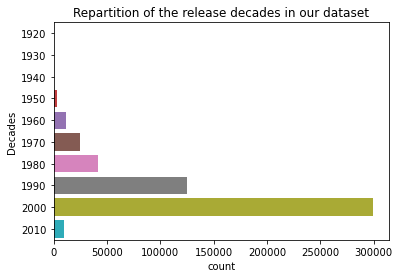

In [31]:
sns.countplot(y="Decades",data=df)
plt.title("Repartition of the release decades in our dataset")

We can see that there are way more songs which were released in the decade 2000 (so between 2000 and 2009). We also can note that there are almost no musics which were released before decade 1950 (in our dataset). So we decide to remove the songs which were released before 1950, and also we want to have approximately the same number of data for each decade. So we will take randomly 3100 samples for each decade. As we have 7 decades (1950, 1960, 1970, 1980, 1990, 2000, 2010), we will have 21700 rows.

Text(0.5, 1.0, 'Repartition of the release decades in our modified dataset')

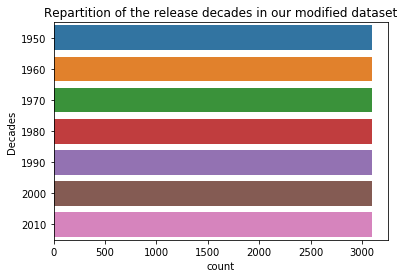

In [4]:
df_temp=df[df.Decades>1940]
df_modify=pd.DataFrame(columns=df_temp.columns)
for i in range(1950,2020,10):
    df_modify=df_modify.append(df[df.Decades==i].sample(n=3100))
    df_modify['Year']=df_modify['Year'].astype(int)
    df_modify['Decades']=df_modify['Decades'].astype(int)
sns.countplot(y="Decades",data=df_modify)
plt.title("Repartition of the release decades in our modified dataset")

### Show correlations

In [5]:
df_modify_corr=df_modify.corr(method="pearson")
df_modify_corr

,timbre_average1,timbre_average2,timbre_average3,timbre_average4,timbre_average5,timbre_average6,timbre_average7,timbre_average8,timbre_average9,timbre_average10,...,timbre_covariance81,timbre_covariance82,timbre_covariance83,timbre_covariance84,timbre_covariance85,timbre_covariance86,timbre_covariance87,timbre_covariance88,timbre_covariance89,timbre_covariance90
timbre_average1,1.000000,0.545095,0.209023,0.109501,-0.254833,-0.278708,0.202903,-0.126504,0.212075,0.036664,...,-0.371492,0.222863,-0.157580,0.030629,0.148419,-0.045201,0.054856,-0.103389,-0.096472,-0.170069
timbre_average2,0.545095,1.000000,-0.011627,0.141430,-0.146602,-0.147396,0.163438,0.016085,0.100297,0.274130,...,-0.309995,0.100085,-0.176170,0.022594,0.150335,0.039773,-0.016989,0.004345,-0.095485,-0.150792
timbre_average3,0.209023,-0.011627,1.000000,0.301154,-0.148934,0.130407,-0.037660,0.055803,0.091934,-0.123076,...,0.083670,0.160574,0.160265,0.055891,-0.036286,-0.059584,0.111746,0.015561,-0.029715,0.140254
timbre_average4,0.109501,0.141430,0.301154,1.000000,-0.052399,0.290182,0.327814,-0.003226,-0.012086,0.095180,...,-0.041450,0.017226,0.035491,0.031762,-0.045345,0.032754,0.042406,0.263867,0.061076,0.021519
timbre_average5,-0.254833,-0.146602,-0.148934,-0.052399,1.000000,-0.063067,-0.085064,0.029078,-0.220814,-0.073657,...,0.000777,-0.083998,0.051907,-0.024323,-0.025889,-0.018095,-0.006821,-0.017779,0.025263,0.026785
timbre_average6,-0.278708,-0.147396,0.130407,0.290182,-0.063067,1.000000,-0.262063,0.024786,0.026798,-0.053474,...,0.125319,-0.199734,0.326182,0.137699,-0.068848,0.216012,-0.029865,0.148187,-0.013990,0.044420
timbre_average7,0.202903,0.163438,-0.037660,0.327814,-0.085064,-0.262063,1.000000,0.167576,-0.144484,-0.025665,...,-0.121734,0.118604,-0.104750,0.004052,-0.011945,-0.020422,0.005431,0.071657,0.084838,-0.080476
timbre_average8,-0.126504,0.016085,0.055803,-0.003226,0.029078,0.024786,0.167576,1.000000,-0.236222,0.366497,...,0.055178,-0.060572,0.105582,0.027393,-0.126407,-0.038768,0.003053,0.058277,0.030433,0.044601
timbre_average9,0.212075,0.100297,0.091934,-0.012086,-0.220814,0.026798,-0.144484,-0.236222,1.000000,0.338433,...,-0.014257,0.037806,-0.015512,0.053872,0.065755,0.026057,0.083420,-0.022079,0.001000,0.053671
timbre_average10,0.036664,0.274130,-0.123076,0.095180,-0.073657,-0.053474,-0.025665,0.366497,0.338433,1.000000,...,-0.040642,-0.035008,-0.031422,0.023127,0.030614,0.017233,-0.006230,0.028349,0.006629,-0.006768


To have a better look on these correlations, we can use heatmap from Seaborn and only show the absolute value of the correlation coefficient. If we have an absolute value close to 1, it shows a big correlation between 2 values and if it's close to 0 it shows no correlations.

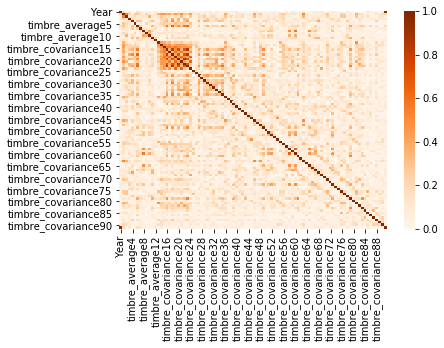

In [10]:
sns.heatmap(abs(df_modify_corr),cmap="Oranges")

As timbre_covariance are already showing information about the correlations, we can build a correlation matrix only with the first 14 columns (target value + timbre_average)

In [32]:
df_modify_corr_2=df_modify.iloc[:,0:13].corr()

<AxesSubplot:>

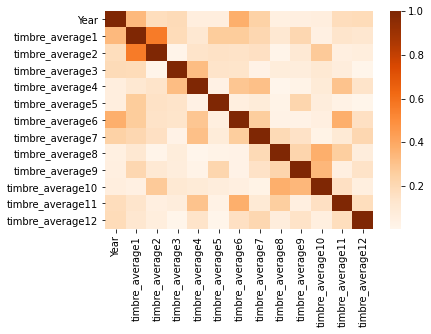

In [33]:
sns.heatmap(abs(df_modify_corr_2),cmap="Oranges")

None of our variables are directly correlated with the Year but we can see that timbre_average1 and timbre_average2 have a pretty high correlation coefficient.

### Data visualizations

As we have explored our data, we can now make some visualization to understand better the links between the variables and the target value.

First, we want to have a global impression on the links between timbre_average and Year.

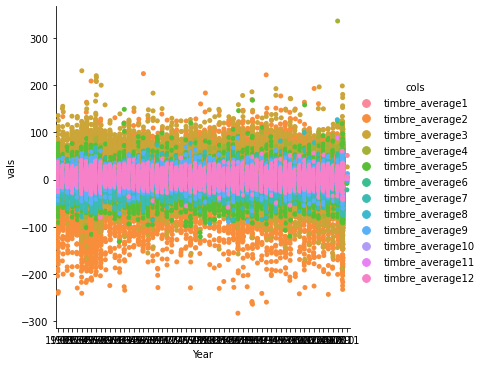

In [33]:
df_modify_2=df_modify.iloc[:,0:13].melt('Year',var_name='cols',value_name='vals')
sns.catplot(x="Year",y="vals", hue='cols', data=df_modify_2)

Text(0.5, 1.0, 'Evolution of the timbre_average values over the years')

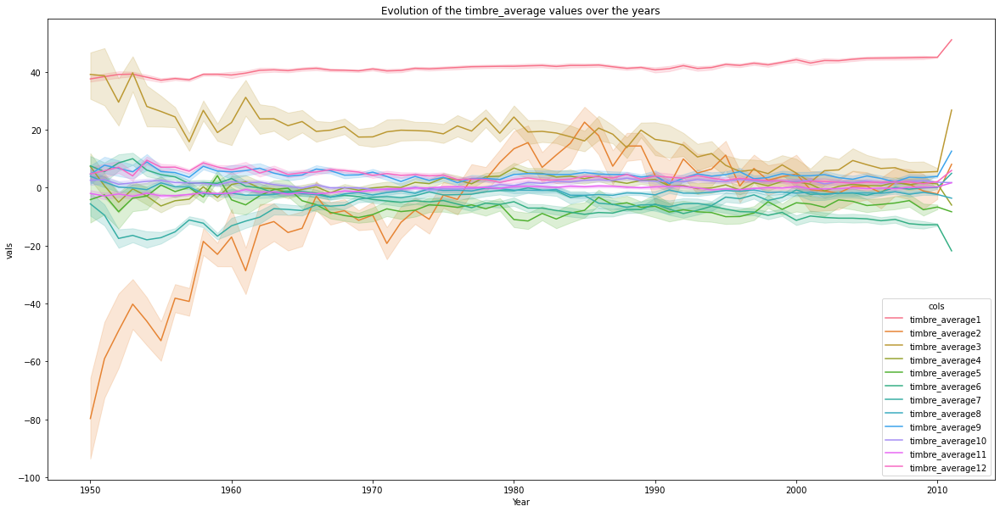

In [39]:
plt.figure(figsize=(20, 10))
sns.lineplot(data = df_modify_2, x='Year',y='vals', hue='cols')
plt.title("Evolution of the timbre_average values over the years")

These 2 plots show that each timbre_average have really different variation intervals. For example, timbre_average1 has values around 40 every year, whereas the values of timbre_average12 vary a lot (between -80 and 0).

* Swarmplot

[Text(0, 0.5, '')]

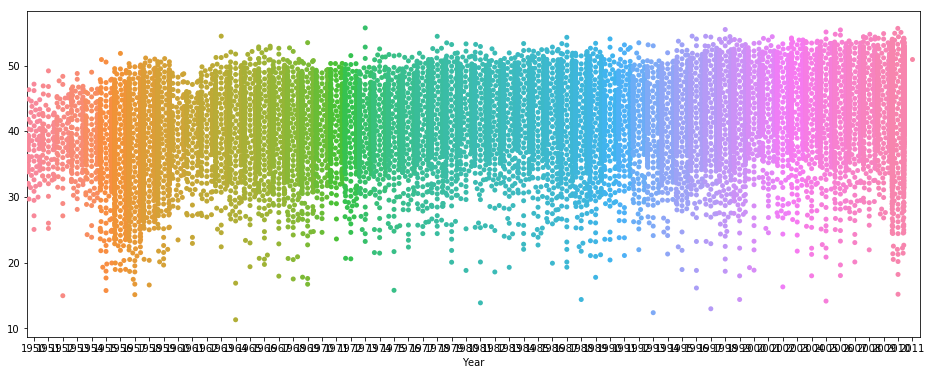

In [43]:
plt.figure(figsize=(16, 6))
ax=sns.swarmplot(x='Year', y='timbre_average1',data=df_modify)
ax.set(ylabel="")

There are a lot of different colors. It might be good to have one color per release decade.

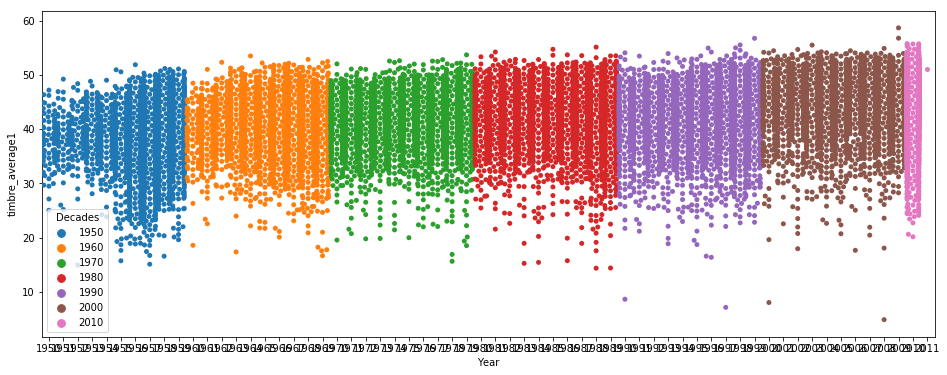

In [13]:
plt.figure(figsize=(16, 6))
ax=sns.swarmplot(x='Year', y='timbre_average1',hue='Decades',data=df_modify)

We want to have a look on this repartition for each timbre_average.

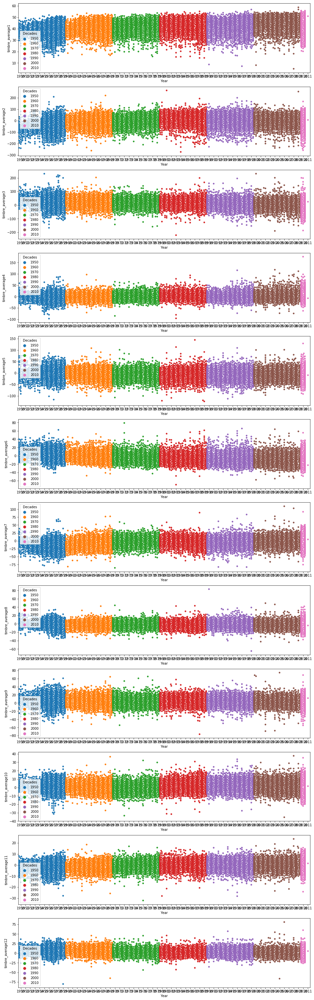

In [12]:
plt.figure(figsize=(16, 60))
for i in range(1,13):
    plt.subplot(13,1,i)
    timbre="timbre_average"+str(i)
    ax=sns.swarmplot(x='Year', y=timbre,hue='Decades',data=df_modify)

To have a better idea of the variation of timbre_average with the year, we can use boxplots.

* Boxplot

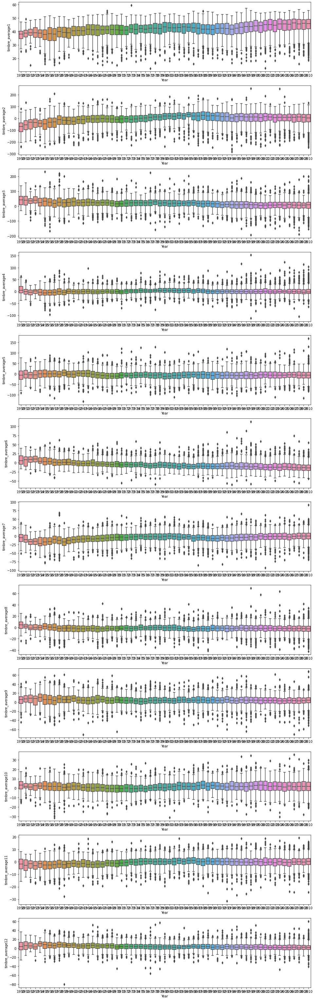

In [41]:
plt.figure(figsize=(16, 60))
for i in range(1,13):
    plt.subplot(13,1,i)
    timbre="timbre_average"+str(i)
    ax = sns.boxplot(x="Year", y=timbre, data=df_modify)

* Lineplot

C:\Users\Morgane\Anaconda3\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


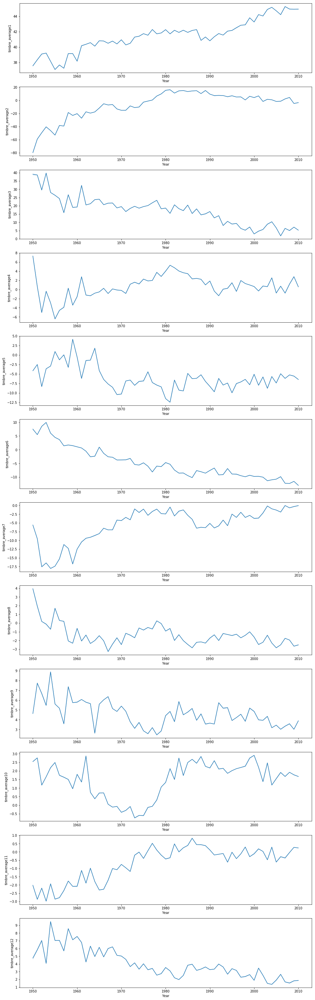

In [54]:
plt.figure(figsize=(16, 60))
for i in range(1,13):
    plt.subplot(13,1,i)
    timbre="timbre_average"+str(i)
    ax = sns.lineplot(x='Year', y=timbre,
                  data=df_modify, ci=False)

* Bokeh

We tried to use Bokeh in order to have a dynamic plot but we didn't succeed. The slider doesn't update our plot because of the function update_data. We saw on stackoverflow that we should use a Java script to refresh the dataframe.

In [5]:
p=figure(title='Values of timbre_average over the years',
         x_axis_label='Year',
         y_axis_label='timbre_average values')

p.circle('Year','timbre_average1',source=df_modify,size = 5, color = "navy", alpha = 0.5)

slider = Slider(title="timbre_average", value=1, start=1, end=12, step=1)

def update_data(attrname, old, new):

    # Get the current slider values
    t=slider.value
    source.data=dict(x=df_modify['Year'],y=df_modify['timbre_average'+str(t)])

for controls in [slider]:
    controls.on_change('value', update_data)

inputs=column(slider)
 
curdoc().add_root(row(inputs, p, width=800))
curdoc().title = "Sliders"

layout = row(p, column(slider))

output_file("slider.html", title="slider.py example")
output_notebook()
show(layout)

Loading BokehJS ...

You are generating standalone HTML/JS output, but trying to use real Python
callbacks (i.e. with on_change or on_event). This combination cannot work.

Only JavaScript callbacks may be used with standalone output. For more
information on JavaScript callbacks with Bokeh, see:

    https://docs.bokeh.org/en/latest/docs/user_guide/interaction/callbacks.html

Alternatively, to use real Python callbacks, a Bokeh server application may
be used. For more information on building and running Bokeh applications, see:

    https://docs.bokeh.org/en/latest/docs/user_guide/server.html



You are generating standalone HTML/JS output, but trying to use real Python
callbacks (i.e. with on_change or on_event). This combination cannot work.

Only JavaScript callbacks may be used with standalone output. For more
information on JavaScript callbacks with Bokeh, see:

    https://docs.bokeh.org/en/latest/docs/user_guide/interaction/callbacks.html

Alternatively, to use real Python callbacks, a Bokeh server application may
be used. For more information on building and running Bokeh applications, see:

    https://docs.bokeh.org/en/latest/docs/user_guide/server.html



## PART 2 : Modelisation

### Introduction

Thanks to our data visualizations, we could understand better how the different timbre_average are linked to the release year of the songs. If we vary the different timbre_average, the year also vary, more or less, but not really with a linear behavior. 
We want to predict the release year of the songs thanks to the 12 timbre_average. 

First, we remove the timbre_covariance values of our dataset as they only give further information about links between 2 timbre_average values but not information about links between timbre_average and release year (so they can't help for prediction).

Our problem is a <b>Classification</b> problem. The different categories are the different years between 1922 and 2011, which represent a lot of categories ! That's why we decided to transform our problem in : "<b>Predict release decade of songs</b>". Thanks to this transformation, we only have 10 categories : 1920 (1920 to 1929), 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000 and 2010.

Finally, the new dataset we will use to try different models is df_model. It contains <b>13 columns</b> : the 12 timbre_average and the decade. For this part, we will use every row of our dataset (<b>515345 rows</b>) to be sure that we don't lose any information.

In [4]:
df_model=df.iloc[:,1:13] 
df_model['Decades']=df.iloc[:,91]
df_model.shape #df_model contains 12 timbre_average and 1 column for Decade

(515345, 13)

First, we need to split our dataset (df_model) into train and test sets. We decide to have 70% of our data in the train_set and 30% in the test_set.

In [5]:
from sklearn.model_selection import train_test_split
df_train, df_test = train_test_split(df_model, train_size=0.70)
df_train.shape, df_test.shape

((360741, 13), (154604, 13))

Then, we need to organize both sets into X=attributes and y=target_value

In [6]:
X_train=df_train.iloc[:,:12] #our attributes: timbre_average1 to 12
y_train=df_train.iloc[:,12] #our target value: decade
X_train.shape, y_train.shape

((360741, 12), (360741,))

In [7]:
X_test=df_test.iloc[:,:12]
y_test=df_test.iloc[:,12]
X_test.shape, y_test.shape

((154604, 12), (154604,))

### Exploration of Classification models

We will now explore several classification models, in order to have an impression of which model fits the best our problem. Then, we will select our best model and try to optimize it, to get a better accuracy. We import accuracy_score to calculate the accuracy of our predictions for each model.

In [8]:
from sklearn.metrics import accuracy_score

#### Decision Tree

We are dealing with a Classification problem so we need to import DecisionTreeClassifier (and not DecisionTreeRegressor).

In [10]:
from sklearn.tree import DecisionTreeClassifier

We initialize our Classifier and fit it to our train set.

In [15]:
dt=DecisionTreeClassifier()
dt.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')

We use this model to predict the values of y_test.

In [16]:
y_pred=dt.predict(X_test)
y_pred

array([2000, 2000, 1980, ..., 2000, 1990, 2000], dtype=int64)

We obtain a list of values which correponds to the release decades of the songs (whose timbre_averages were given in X_test). We use now accuracy_score to calculate the accuracy of our model on the train set and on the test set.

In [17]:
print('Accuracy Score on df_train: ', accuracy_score(y_true=y_train, y_pred=dt.predict(X_train)))
print('Accuracy Score on df_test: ', accuracy_score(y_true=y_test, y_pred=y_pred))

Accuracy Score on df_train:  0.9999972279280703
Accuracy Score on df_test:  0.47811828930687433


The accuracy is close to 100% on the train set whereas it's only 47.8% on the test set. There is an overfitting ! We can change the parameters of our decision tree in order to avoid the overfitting. The main parameter is max_depth. So we define a function which take the max_depth as argument and will modify this value to see its influence on the accuracy.

In [18]:
def DTC(maxdepth):
    dt=DecisionTreeClassifier(max_depth=maxdepth)
    dt.fit(X_train, y_train)
    y_pred=dt.predict(X_test)
    y_pred
    print('Accuracy Score on df_train: ', accuracy_score(y_true=y_train, y_pred=dt.predict(X_train)))
    print('Accuracy Score on df_test: ', accuracy_score(y_true=y_test, y_pred=y_pred))

In [19]:
DTC(10)

Accuracy Score on train data:  0.6082230741723286
Accuracy Score on test data:  0.5947840935551474


The overfitting disapeared ! We have almost the same accuracy on the train_set and on the test_set.

In [20]:
DTC(20)

Accuracy Score on train data:  0.8425463143917659
Accuracy Score on test data:  0.5205298698610644


In [21]:
DTC(15)

Accuracy Score on train data:  0.6861072071098101
Accuracy Score on test data:  0.5664083723577656


In [22]:
DTC(12)

Accuracy Score on train data:  0.6269789128488306
Accuracy Score on test data:  0.587617396703837


In [23]:
DTC(7)

Accuracy Score on train data:  0.5957293459850697
Accuracy Score on test data:  0.5933934438953714


It looks like our "best" parameter is max_depth=10.

We would like to plot our tree but as we have too many values, it wouldn't be readable.

#### Random Forest

In [9]:
from sklearn.ensemble import RandomForestClassifier

As for the DecisionTreeClassifier, the main parameter is the max_depth so we create a function which takes this as parameter.

In [40]:
def RF(maxdepth):
    rf = RandomForestClassifier(max_depth=maxdepth, random_state=0)
    rf.fit(X_train, y_train)
    y_pred=rf.predict(X_test)
    print('Accuracy Score on df_train: ', accuracy_score(y_true=y_train, y_pred=rf.predict(X_train)))
    print('Accuracy Score on df_test: ', accuracy_score(y_true=y_test, y_pred=y_pred))

In [26]:
RF(10)

C:\Users\Morgane\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Accuracy Score on df_train:  0.6042895041040525
Accuracy Score on df_test:  0.5959224858347779


In [27]:
RF(20)

C:\Users\Morgane\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Accuracy Score on df_train:  0.8486476447090849
Accuracy Score on df_test:  0.5975265840469846


In [28]:
RF(15)

C:\Users\Morgane\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Accuracy Score on df_train:  0.6839255865011186
Accuracy Score on df_test:  0.603548420480712


The best maxdepth seems to be 15 as we obtain an accuracy of 60% for the test set!

#### Logistic Regression

In [29]:
from sklearn.linear_model import LogisticRegression

In [31]:
lg = LogisticRegression()
lg.fit(X_train, y_train)
y_pred=lg.predict(X_test)
print('Accuracy Score on df_train: ', accuracy_score(y_true=y_train, y_pred=lg.predict(X_train)))
print('Accuracy Score on df_test: ', accuracy_score(y_true=y_test, y_pred=y_pred))

C:\Users\Morgane\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:433: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
C:\Users\Morgane\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:460: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


Accuracy Score on df_train:  0.5867506050046987
Accuracy Score on df_test:  0.5860585754572973


The accuracy is 58% for both train and test sets, so this is less than with our Random Forest Classifier.

#### Gaussian Naive Bayes

In [130]:
from sklearn.naive_bayes import GaussianNB

In [131]:
gnb=GaussianNB()
gnb.fit(X_train,y_train)

GaussianNB(priors=None, var_smoothing=1e-09)

In [132]:
y_pred=gnb.predict(X_test)
y_pred

array([1990, 2000, 2000, ..., 2000, 2000, 2000], dtype=int64)

In [133]:
print('Accuracy Score on df_train: ', accuracy_score(y_true=y_train, y_pred=gnb.predict(X_train)))
print('Accuracy Score on df_test: ', accuracy_score(y_true=y_test, y_pred=y_pred))

Accuracy Score on train data:  0.5574997020022675
Accuracy Score on test data:  0.5544552534216449


The accuracy is even smaller than with Logistic Regression.

#### Gradient Boosting

In [32]:
from sklearn.ensemble import GradientBoostingClassifier

In [34]:
gb=GradientBoostingClassifier()
gb.fit(X_train,y_train)

GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=0.1, loss='deviance', max_depth=3,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_samples_split=2,
              min_weight_fraction_leaf=0.0, n_estimators=100,
              n_iter_no_change=None, presort='auto', random_state=None,
              subsample=1.0, tol=0.0001, validation_fraction=0.1,
              verbose=0, warm_start=False)

In [35]:
y_pred=dt.predict(X_test)
y_pred

array([2000, 2000, 1980, ..., 2000, 1990, 2000], dtype=int64)

In [36]:
print('Accuracy Score on df_train: ', accuracy_score(y_true=y_train, y_pred=gb.predict(X_train)))
print('Accuracy Score on df_test: ', accuracy_score(y_true=y_test, y_pred=y_pred))

Accuracy Score on df_train:  0.6073692760179741
Accuracy Score on df_test:  0.47811828930687433


#### Support Vector Classifier

This model takes too much time so we decided to fit it on a smaller dataset : the one we used for our data visualizations.

In [10]:
df_model_small=df_modify.iloc[:,1:13] 
df_model_small['Decades']=df_modify.iloc[:,91]

df_train_small, df_test_small = train_test_split(df_model_small, train_size=0.70)

X_train_small=df_train_small.iloc[:,:12] #our attributes: timbre_average1 to 12
y_train_small=df_train_small.iloc[:,12] #our target value: year

X_test_small=df_test_small.iloc[:,:12]
y_test_small=df_test_small.iloc[:,12]

In [11]:
from sklearn.svm import SVC

In [12]:
svc = SVC()
svc.fit(X_train_small, y_train_small)

SVC()

In [15]:
y_pred=svc.predict(X_test_small)
y_pred
print('Accuracy Score on df_train_small: ', accuracy_score(y_true=y_train_small, y_pred=svc.predict(X_train_small)))
print('Accuracy Score on df_test_small: ', accuracy_score(y_true=y_test_small, y_pred=y_pred))

Accuracy Score on df_train_small:  0.4057541641977747
Accuracy Score on df_test_small:  0.36661035171248657


The accuracy is small but we can explain this : we only used a really small part of our dataset (21700 rows instead of 515345). Maybe this model would have been better than the others if we would have used the entire dataset.

### Exploratory of different hypotheses

#### What happens if we predict years instead of decades ?

Our max accuracy on the test set with our best model is 60% when we try to predict the year. It is not that hight. So we thought that maybe it is linked with the fact that we predict decade instead of year. To be sure, we tried to predict the year using our best model (Random Forest max_depth=15).

In [11]:
df_model2=df.iloc[:,0:13] 

df_train2, df_test2 = train_test_split(df_model2, train_size=0.70)

X_train2=df_train2.iloc[:,1:13] #our attributes: timbre_average1 to 12
y_train2=df_train2.iloc[:,0] #our target value: year

X_test2=df_test2.iloc[:,1:13]
y_test2=df_test2.iloc[:,0]

In [12]:
rf = RandomForestClassifier(max_depth=15)
rf.fit(X_train2, y_train2)
y_pred=rf.predict(X_test2)
print('Accuracy Score on df_train2: ', accuracy_score(y_true=y_train, y_pred=rf.predict(X_train2)))
print('Accuracy Score on df_test2: ', accuracy_score(y_true=y_test, y_pred=y_pred))

Accuracy Score on df_train2:  0.011614981385536991
Accuracy Score on df_test2:  0.005989495743965227


The accuracy is now close to 0%... Our first impression was good : we can't predict the year as there are way too many categories.

#### What happens if we only take timbre_average1 and timbre_average2 as predictors ?

In [18]:
df_model3=df.iloc[:,1:3] 
df_model3['Decades']=df.iloc[:,91]

df_train3, df_test3 = train_test_split(df_model3, train_size=0.70)

X_train3=df_train3.iloc[:,:2] #our attributes: timbre_average1 and timbre_average2
y_train3=df_train3.iloc[:,2] #our target value: decade

X_test3=df_test3.iloc[:,:2]
y_test3=df_test3.iloc[:,2]
X_test3.shape, y_test3.shape

((154604, 2), (154604,))

In [19]:
rf = RandomForestClassifier(max_depth=15)
rf.fit(X_train3, y_train3)
y_pred=rf.predict(X_test3)
print('Accuracy Score on df_train3: ', accuracy_score(y_true=y_train3, y_pred=rf.predict(X_train3)))
print('Accuracy Score on df_test3: ', accuracy_score(y_true=y_test3, y_pred=y_pred))

Accuracy Score on df_train3:  0.6107927848511813
Accuracy Score on df_test3:  0.5830573594473623


We can see that timbre_average1 and timbre_average2 are the better predictors as they leads to an accuracy of 58% ! But the accuracy is still a bit better if we take all the timbre_average values.

#### Conclusion of our explorations

Our best model seems to be Random Forest Classifier with max_depth=15, trained with all the rows of our dataset (with the train set) and with all timbre_average values. To optimize it even more, we decided to make a GridSearch and vary other parameters. We don't need to make a K-fold cross validation as we have really a lot of rows in our dataset ! Also, during our explorations, we splited our datset several time and tried our models several times, we always got the same accuracy (more or less 0.5%).

### Hyperparameter tuning

In [12]:
from sklearn.model_selection import GridSearchCV
from matplotlib import gridspec

In [13]:
param_grid={
    "max_depth" : np.arange(14, 16, 1),
    "criterion" : ["gini", "entropy"],
    "min_samples_leaf" : np.arange(1,3,1)
}
grid = GridSearchCV(
    estimator=RandomForestClassifier(),
    param_grid=param_grid,
    scoring="neg_mean_squared_error",
)

In [14]:
grid.fit(X_train, y_train)
grid.best_estimator_

RandomForestClassifier(max_depth=15, min_samples_leaf=2)

We can see the best 2 parameters : max_depth=15 and min_samples_leaf=2. The GridSearch doesn't show us the best parameter in terms of criterion.. So we will keep the default one.

### Conclusion

Our best model is RandomForestClassifier used with those parameters : max_depth=15 and min_samples_leaf=2.

Now, we can compute the accuracy and show the confusion matrix.

In [10]:
rf=RandomForestClassifier(max_depth=15, min_samples_leaf=2) #changer les paramètres avec les meilleurs
rf.fit(X_train, y_train)
y_pred=rf.predict(X_test)
print('Accuracy Score on df_train: ', accuracy_score(y_true=y_train, y_pred=rf.predict(X_train)))
print('Accuracy Score on df_test: ', accuracy_score(y_true=y_test, y_pred=y_pred))

Accuracy Score on df_train:  0.6811119334924502
Accuracy Score on df_test:  0.6098483868463946


In [11]:
from sklearn.metrics import confusion_matrix
confusion_matrix(y_test, y_pred)

array([[    0,     0,     0,     0,     0,     0,     0,    44,    23,
            0],
       [    0,     0,     0,     0,     0,     0,     0,    51,    22,
            0],
       [    0,     0,     0,     0,     0,     0,     0,    59,    38,
            0],
       [    0,     0,     0,     0,     0,     0,     1,   229,   680,
            0],
       [    0,     0,     0,     0,     0,     9,    38,   799,  2660,
            0],
       [    0,     0,     0,     0,     0,    34,   185,  1778,  5532,
            0],
       [    0,     0,     0,     0,     0,    13,   848,  3910,  7792,
            0],
       [    0,     0,     0,     0,     0,    12,   396,  8316, 28598,
            0],
       [    0,     0,     0,     0,     0,    11,   163,  4514, 85086,
            0],
       [    0,     0,     0,     0,     0,     0,     6,    84,  2672,
            1]], dtype=int64)

Text(0.5, 1.0, 'Confusion Matrix')

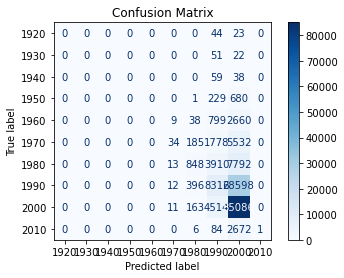

In [12]:
from sklearn.metrics import plot_confusion_matrix
plot_confusion_matrix(rf, X_test, y_test, cmap=plt.cm.Blues)
plt.title('Confusion Matrix')

The accuracy is not high even with our best model. We can explain this with the fact that the timbre_average values are not perfect predictors for the release year of a song. Other parameters would help better to predict the year.